# Self-Driving Car Nanodegree

## Project 4: Advanced Lane Finding

Miguel Morales | [@mimoralea](https://twitter.com/mimoralea) | [mimoralea@gmail.com](mailto:mimoralea@gmail.com)

In this project, we used advanced Computer Vision techniques to find road lane lines on images and video streams. First, we calibrated the camera obtaining the camera matrix and distortion coefficients. Then we created a pipeline of advanced methods to correctly identify lane line pixels, and finally applied these methods to video streams using confidence levels to detect and track the lines through the video.

### Camera Calibration

No sensor is perfect, and a camera is just one more sensor. To make sure the images and videos we get from cameras are the best possible representation of the world they are sensing, there are some calibration steps we can perform. Thankfully, OpenCV makes this process very straight-forward.

#### Obtaining matrix and coefficients

First, lets load some libraries and functions that we will be using throughout the project:

In [46]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from scipy import ndimage
from ipywidgets import (widgets, interactive, FloatSlider, IntSlider, \
                        IntRangeSlider, FloatRangeSlider, RadioButtons)

import numpy as np
import cv2
import pylab
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

def get_calibration_coef(cal_imgs, nx=9, ny=6, plot=False):
    objpoints = []
    imgpoints = []
    drawnimgs = []
    
    objp = np.zeros((nx*ny, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

    fnames = glob.glob(cal_imgs)

    for fname in fnames:
        img = mpimg.imread(fname)

        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # if chessboard corners were not found, continue to next image
        if not ret:
            continue

        # save the points to calibrate later
        imgpoints.append(corners)
        objpoints.append(objp)

        # no need to waste cycles if do not want plotting
        if not plot:
            continue

        # draw points in the img and save a copy
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        drawnimgs.append(img)

    return objpoints, imgpoints, drawnimgs

def calibrate(img_shape, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
        objpoints, imgpoints, img_shape, None, None)
    return mtx, dist

def undistort(img, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

def cal_undistort(img, objpoints, imgpoints, mtx=None, dist=None):

    if mtx==None or dist==None:
        mtx, dist = calibrate(img.shape[0:2], objpoints, imgpoints)

    undist = undistort(img, mtx, dist)
    return undist, mtx, dist

def plot_imgs(imgs, titles=None):
    fig = plt.figure(figsize=(20,50))
    for i in range(len(imgs)):
        img = imgs[i]

        ax = fig.add_subplot(9, 3, i + 1)
        ax.grid(False)
        ax.get_xaxis().set_ticks([])
        ax.get_yaxis().set_ticks([])
        ax.imshow(img, cmap='gray')
        if titles != None:
            ax.set_title(titles[i], fontsize=50)
    plt.show()

def plot_side_by_side(img1, title1, img2, title2):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img1, cmap='gray')
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(img2, cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

def get_perspective(img_size, src=None, dst=None, inv=False):
    x, y = img_size

    if src == None or dst == None:
        src = np.float32([
                (100, y),
                (x/2 - 150, y*5/7),
                (x/2 + 150, y*5/7),
                (x - 100, y)
            ])
        dst = np.float32([
                (100, y),
                (100, 0),
                (x - 100, 0),
                (x - 100, y)
            ])
    return cv2.getPerspectiveTransform(src, dst) if not inv else cv2.getPerspectiveTransform(dst, src)

def corners_unwarp(img, mtx, dist, src=None, dst=None):
    img_size = (img.shape[1], img.shape[0])
    M = get_perspective(img_size, src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags = cv2.INTER_LINEAR)
    return warped, M

Next, we can obtain the calibration matrix and coefficients from the provided images:

In [2]:
udobjpoints, udimgpoints, udimgs = get_calibration_coef('ud_cal/calibration*.jpg', plot=True)

Also, Let's take a look at the images that we used to obtain the calibration parameters:

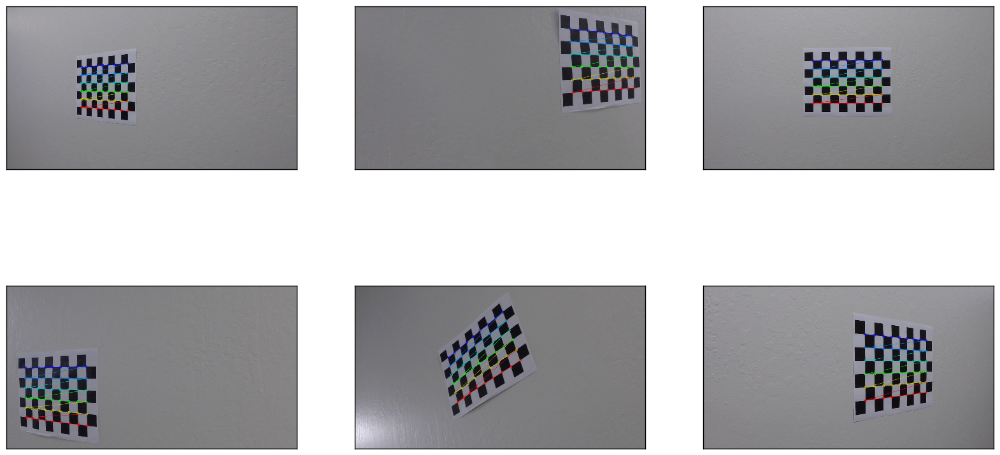

In [3]:
plot_imgs(udimgs[0:6])

We will also be using some images and videos taken with another camera, so let's obtain the matrix and coefficients for this camera as well. Additionally, let's also plot some of the images we used to do this new calibration.

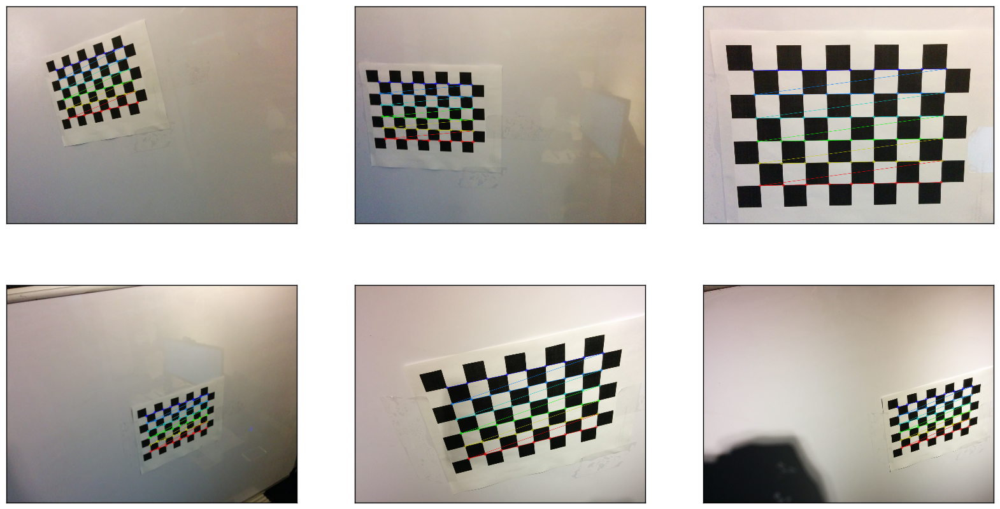

In [4]:
myobjpoints, myimgpoints, myimgs = get_calibration_coef('my_cal/calibration*.jpg', plot=True)
plot_imgs(myimgs[0:6])

#### Undistorting test images

We obtained the matrices and coefficients from the previous step. These values can be used to distort new images we pass into. But also, from this step, we get a matrix and a distortion values that we can reuse later on.

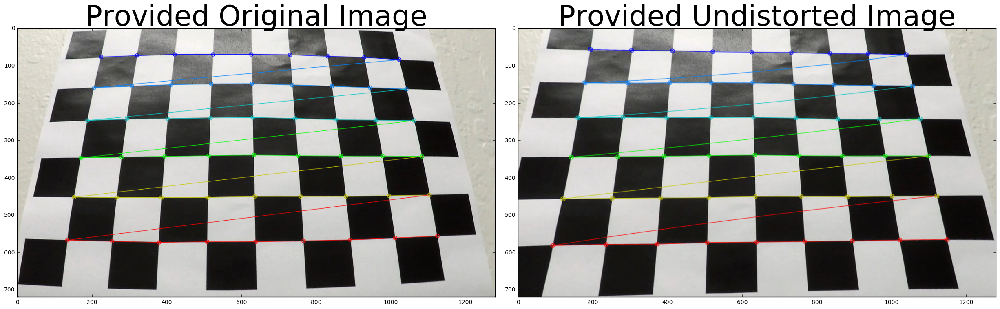

In [5]:
udimg = udimgs[10]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints)
plot_side_by_side(udimg, 'Provided Original Image', udundistorted, 'Provided Undistorted Image')

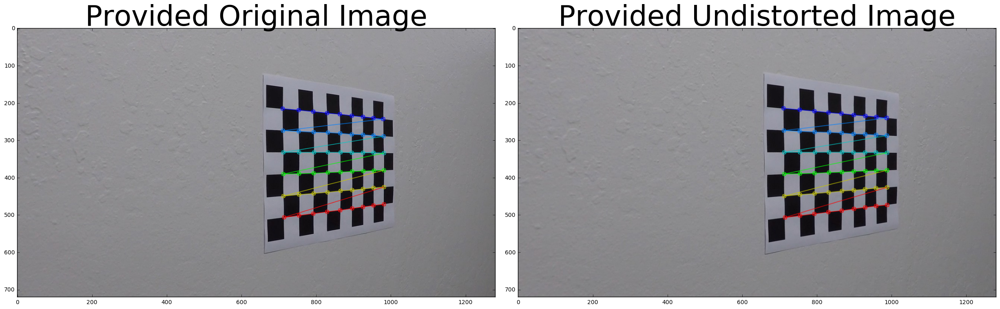

In [6]:
udimg = udimgs[5]
udundistorted, udmtx, uddist = cal_undistort(udimg, udobjpoints, udimgpoints, udmtx, uddist)
plot_side_by_side(udimg, 'Provided Original Image', udundistorted, 'Provided Undistorted Image')

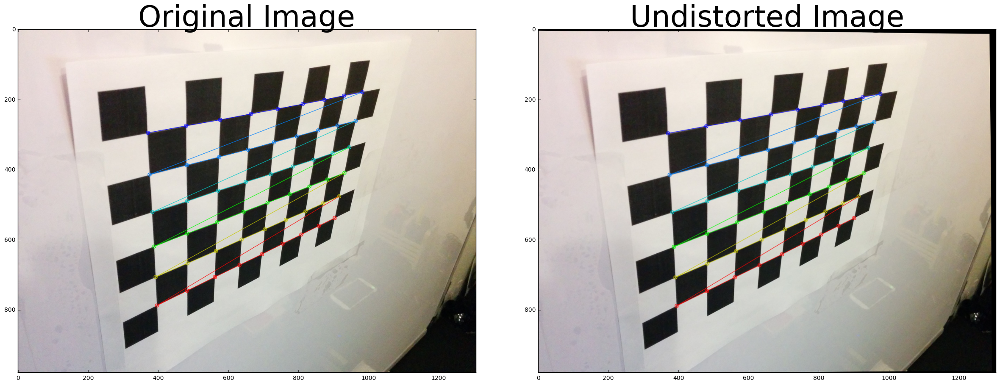

In [7]:
myimg = myimgs[-3]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

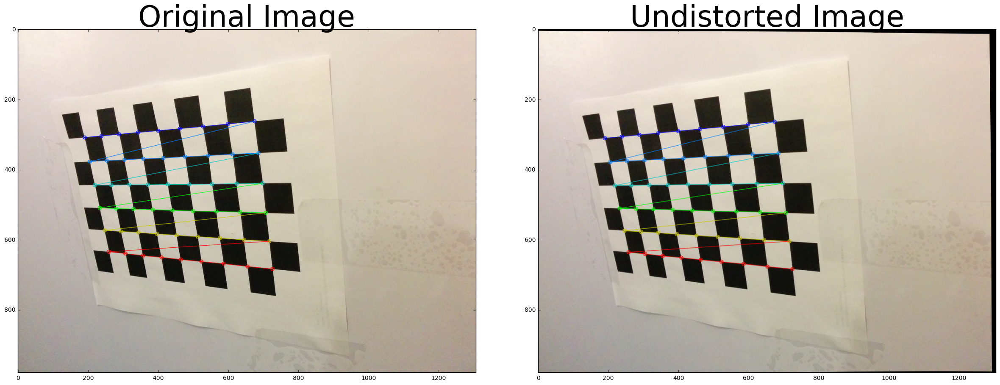

In [8]:
myimg = myimgs[10]
myundistorted, mymtx, mydist = cal_undistort(myimg, myobjpoints, myimgpoints, mymtx, mydist)
plot_side_by_side(myimg, 'Original Image', myundistorted, 'Undistorted Image')

Excellent. In steps above, we were able to calibrate a camera and use it to undistort images. Let's now work into building an advanced Computer Vision pipeline to effectively detect and track lane lines on roads.

### Pipeline

In this section, we will dive deep into the Computer Vision techniques used to detect lane lines in roads of diverse conditions. First, we will look at each processing step of the pipeline in detail, and then we will create a function to process images with a single call. Additionally, we will be looking at two sample images side by side. The first image shows two dashed white lines with only a shade interrupting the flow of the lane, the second image however, shows multiple potential issues for the lane detection. The left line is continuous and yellow, while the right is white. Also, there is a big change in the roads from asphalt to concrete. Let's take a look.

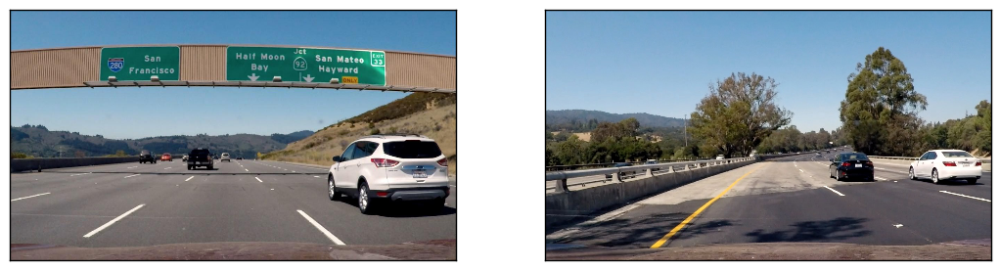

In [9]:
udimg1 = mpimg.imread('ud_images/signs_vehicles_xygrad.jpg')
udimg2 = mpimg.imread('ud_images/test4.jpg')

plot_imgs([udimg1, udimg2])

#### Distortion Correction

The first step of the pipeline is to correct the distortion of the image above. As we can see, this camera clearly shows radial distortion as we can see how some lines that appear to be curved intuitively shouldn't. Good news is, we already have the camera matrix and distortion coefficients, so we can simply use these values to undistort any new image.

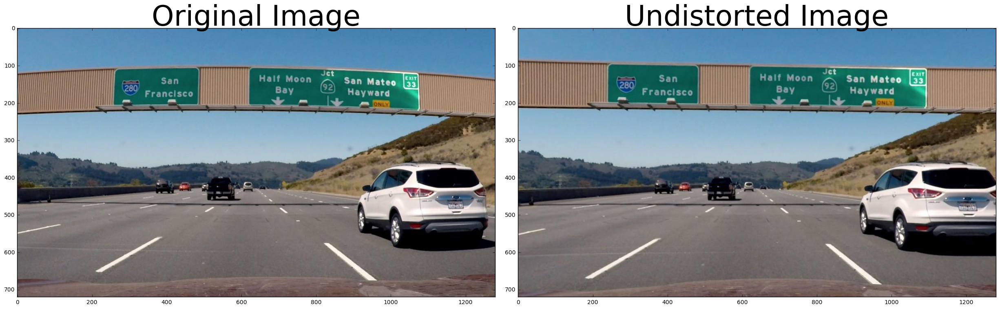

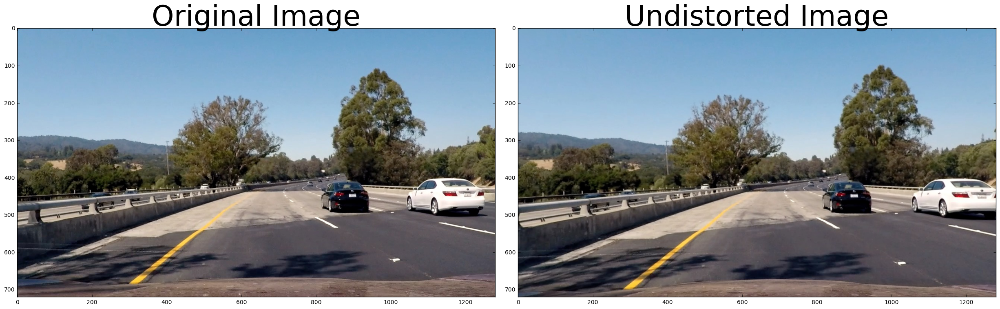

In [10]:
und1 = undistort(udimg1, udmtx, uddist)
und2 = undistort(udimg2, udmtx, uddist)
plot_side_by_side(udimg1, 'Original Image', und1, 'Undistorted Image')
plot_side_by_side(udimg2, 'Original Image', und2, 'Undistorted Image')

#### Binary Image Creation

First, let's add some functions to use for the binary images exploration.

In [11]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    sobel = sobelx if orient == 'x' else sobely
    
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(abs_sobel)/255 
    scaled_sobel = (abs_sobel/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)

    # 3) Take the absolute value of the derivative or gradient
    sobel_mag = np.sqrt(np.square(sobelx) + np.square(sobely))    
    
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scale_factor = np.max(sobel_mag)/255 
    scaled_sobel = (sobel_mag/scale_factor).astype(np.uint8) 
    
    # 5) Create a mask of 1's where the scaled gradient magnitude
    binary = np.zeros_like(scaled_sobel)
    binary[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = img
    
    # 1) Convert to grayscale
    if len(img.shape) == 3:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    dirgrad = np.arctan2(abs_sobely, abs_sobelx)
    
    # 5) Create a binary mask where direction thresholds are met
    binary = np.zeros_like(dirgrad, dtype=int)
    binary[(dirgrad > thresh[0]) & (dirgrad < thresh[1])] = 1
    
    # 6) Return this mask as your binary_output image
    return binary

def hls_select(img, selection='l', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    q = H if selection=='h' else L if selection=='l' else S
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def hsv_select(img, selection='s', thresh=(0, 255)):
    # 1) Convert to HLS color space
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    S = hsv[:,:,1]
    V = hsv[:,:,2]

    q = H if selection=='h' else S if selection=='s' else V
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
    
    return binary

def rgb_select(img, selection='r', thresh=(0, 255)):
    # 1) Convert to HLS color space
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]
    
    q = R if selection=='r' else G if selection=='g' else B
    binary = np.zeros_like(q)
    binary[(q > thresh[0]) & (q <= thresh[1])] = 1
        
    return binary

First, we will explore the different color models. RGB, HLS and HSV, to be more exact. Then, we will look at different kinds of thresholds. Finally, we will look at a couple of good combinations and the combination that we selected as our binary pipeline.

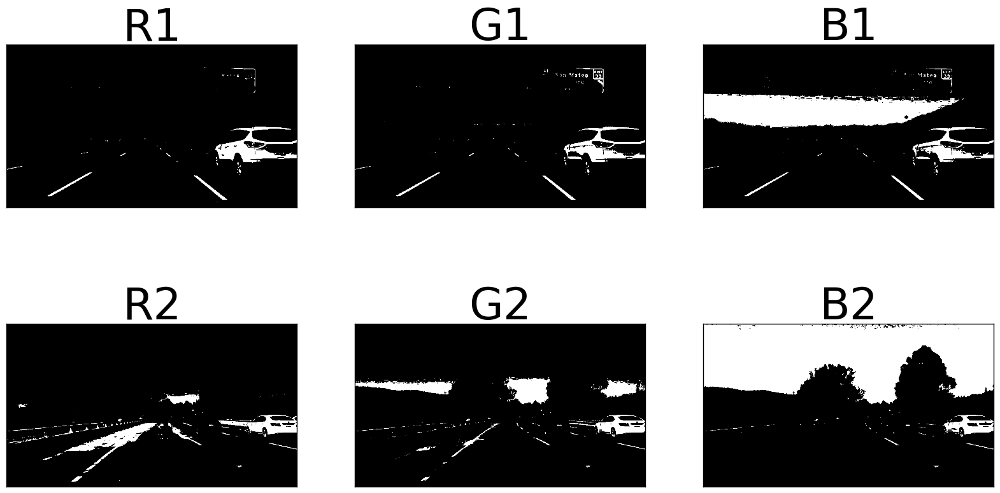

In [12]:
R1 = rgb_select(und1, selection='r', thresh=(200, 255))
G1 = rgb_select(und1, selection='g', thresh=(200, 255))
B1 = rgb_select(und1, selection='b', thresh=(200, 255))

R2 = rgb_select(und2, selection='r', thresh=(200, 255))
G2 = rgb_select(und2, selection='g', thresh=(200, 255))
B2 = rgb_select(und2, selection='b', thresh=(200, 255))

plot_imgs([R1,G1,B1,R2,G2,B2], ['R1','G1','B1','R2','G2','B2'])



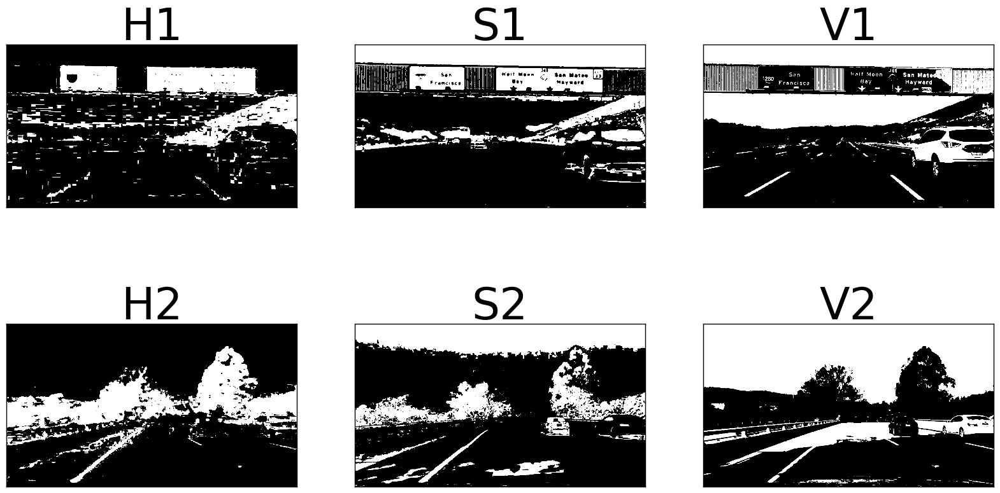

In [13]:
H1 = hsv_select(und1, selection='h', thresh=(15, 100))
S1 = hsv_select(und1, selection='s', thresh=(90, 255))
V1 = hsv_select(und1, selection='v', thresh=(150, 255))

H2 = hsv_select(und2, selection='h', thresh=(15, 100))
S2 = hsv_select(und2, selection='s', thresh=(90, 255))
V2 = hsv_select(und2, selection='v', thresh=(150, 255))

plot_imgs([H1,S1,V1,H2,S2,V2],  ['H1','S1','V1','H2','S2','V2'])

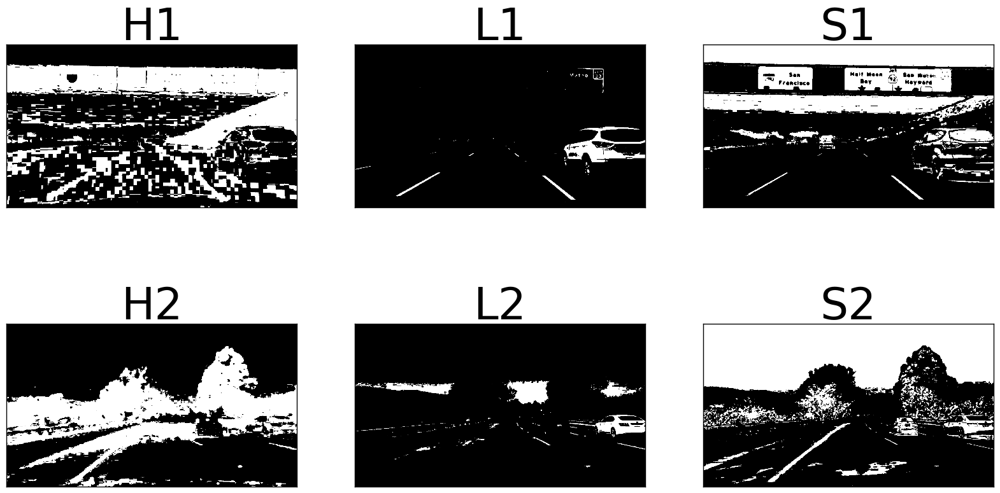

In [14]:
H1 = hls_select(und1, selection='h', thresh=(10, 100))
L1 = hls_select(und1, selection='l', thresh=(200, 255))
S1 = hls_select(und1, selection='s', thresh=(90, 255))

H2 = hls_select(und2, selection='h', thresh=(10, 100))
L2 = hls_select(und2, selection='l', thresh=(200, 255))
S2 = hls_select(und2, selection='s', thresh=(90, 255))

plot_imgs([H1,L1,S1,H2,L2,S2],  ['H1','L1','S1','H2','L2','S2'])

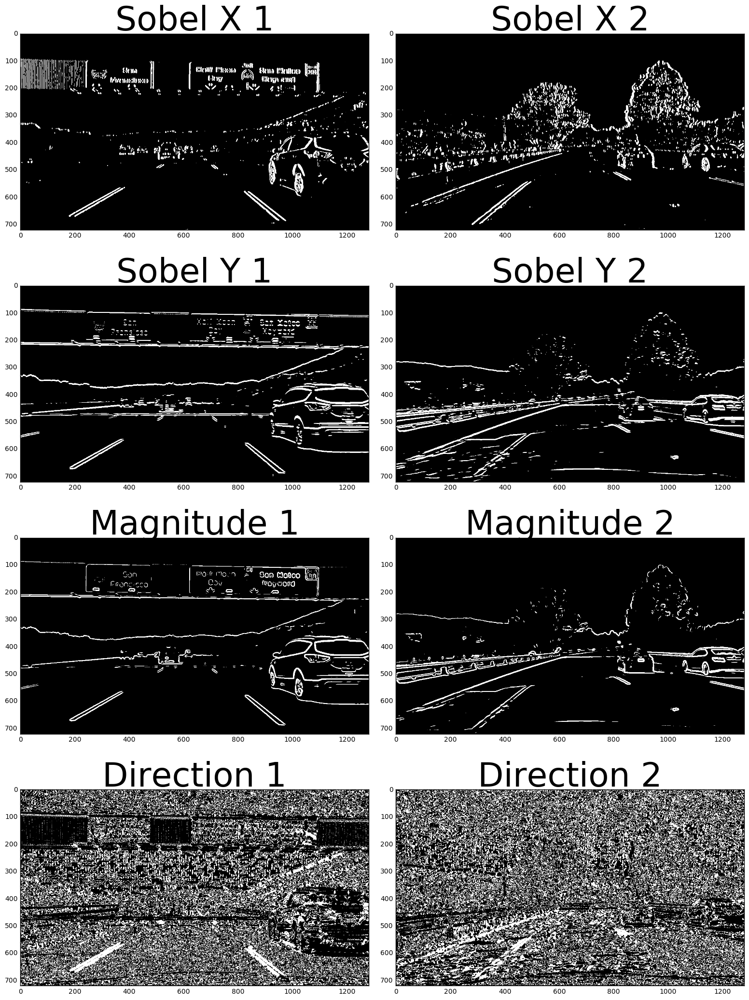

In [15]:
grdx1 = abs_sobel_thresh(und1, orient='x', sobel_kernel=15, thresh=(30, 255))
grdy1 = abs_sobel_thresh(und1, orient='y', sobel_kernel=15, thresh=(50, 255))
magn1 = mag_thresh(und1, sobel_kernel=15, thresh=(70, 255))
drec1 = dir_threshold(und1, sobel_kernel=15, thresh=(.7, 1.3))

grdx2 = abs_sobel_thresh(und2, orient='x', sobel_kernel=15, thresh=(30, 255))
grdy2 = abs_sobel_thresh(und2, orient='y', sobel_kernel=15, thresh=(50, 255))
magn2 = mag_thresh(und2, sobel_kernel=15, thresh=(70, 255))
drec2 = dir_threshold(und2, sobel_kernel=15, thresh=(.7, 1.3))

f, axs = plt.subplots(4, 2, figsize=(15, 10))
f.tight_layout()

ax1, ax2 = axs[0]
ax3, ax4 = axs[1]
ax5, ax6 = axs[2]
ax7, ax8 = axs[3]

ax1.imshow(grdx1, cmap='gray')
ax1.set_title('Sobel X 1', fontsize=50)
ax2.imshow(grdx2, cmap='gray')
ax2.set_title('Sobel X 2', fontsize=50)
ax3.imshow(grdy1, cmap='gray')
ax3.set_title('Sobel Y 1', fontsize=50)
ax4.imshow(grdy2, cmap='gray')
ax4.set_title('Sobel Y 2', fontsize=50)

ax5.imshow(magn1, cmap='gray')
ax5.set_title('Magnitude 1', fontsize=50)
ax6.imshow(magn2, cmap='gray')
ax6.set_title('Magnitude 2', fontsize=50)
ax7.imshow(drec1, cmap='gray')
ax7.set_title('Direction 1', fontsize=50)
ax8.imshow(drec2, cmap='gray')
ax8.set_title('Direction 2', fontsize=50)

plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

Now that we've previewed few different techniques, we can stack up some of these techniques for a more precise detection.

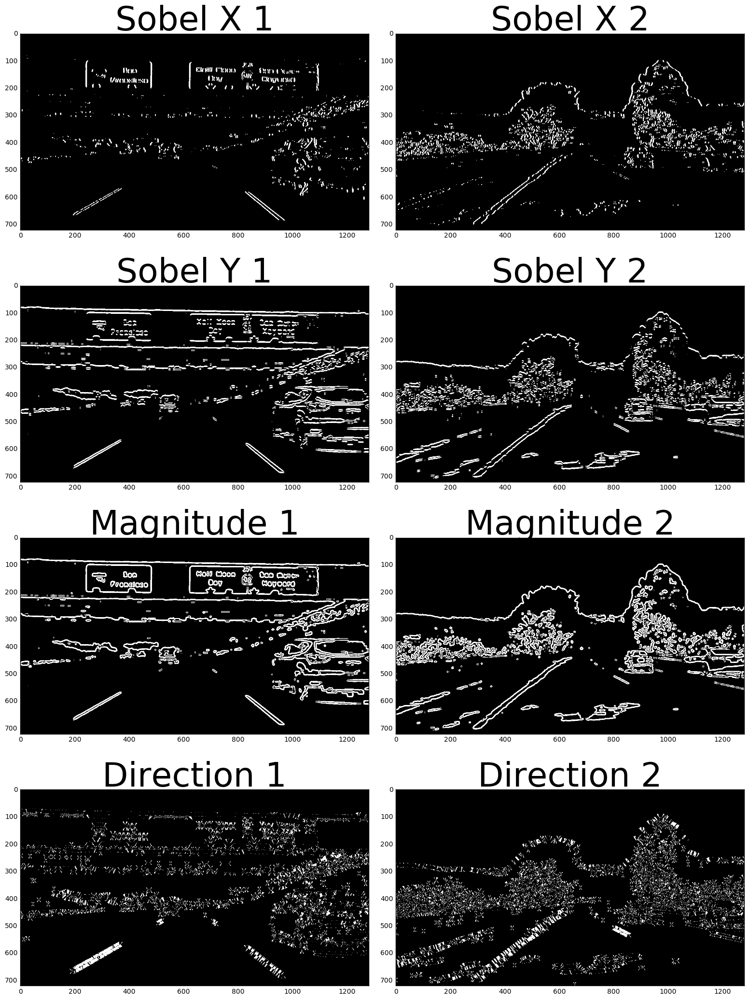

In [16]:
grdx1 = abs_sobel_thresh(S1, orient='x', sobel_kernel=15, thresh=(100, 255))
grdy1 = abs_sobel_thresh(S1, orient='y', sobel_kernel=15, thresh=(100, 255))
magn1 = mag_thresh(S1, sobel_kernel=15, thresh=(100, 255))
drec1 = dir_threshold(S1, sobel_kernel=15, thresh=(.9, 1.2))

grdx2 = abs_sobel_thresh(S2, orient='x', sobel_kernel=15, thresh=(100, 255))
grdy2 = abs_sobel_thresh(S2, orient='y', sobel_kernel=15, thresh=(100, 255))
magn2 = mag_thresh(S2, sobel_kernel=15, thresh=(100, 255))
drec2 = dir_threshold(S2, sobel_kernel=15, thresh=(.9, 1.2))

f, axs = plt.subplots(4, 2, figsize=(15, 10))
f.tight_layout()

ax1, ax2 = axs[0]
ax3, ax4 = axs[1]
ax5, ax6 = axs[2]
ax7, ax8 = axs[3]

ax1.imshow(grdx1, cmap='gray')
ax1.set_title('Sobel X 1', fontsize=50)
ax2.imshow(grdx2, cmap='gray')
ax2.set_title('Sobel X 2', fontsize=50)
ax3.imshow(grdy1, cmap='gray')
ax3.set_title('Sobel Y 1', fontsize=50)
ax4.imshow(grdy2, cmap='gray')
ax4.set_title('Sobel Y 2', fontsize=50)

ax5.imshow(magn1, cmap='gray')
ax5.set_title('Magnitude 1', fontsize=50)
ax6.imshow(magn2, cmap='gray')
ax6.set_title('Magnitude 2', fontsize=50)
ax7.imshow(drec1, cmap='gray')
ax7.set_title('Direction 1', fontsize=50)
ax8.imshow(drec2, cmap='gray')
ax8.set_title('Direction 2', fontsize=50)

plt.subplots_adjust(left=0., right=1, top=2, bottom=0.)
plt.show()

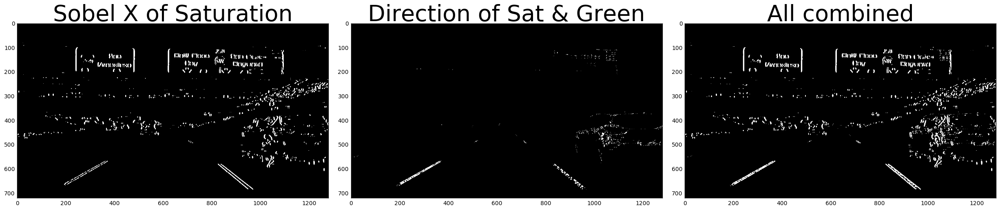

In [17]:
S1 = hls_select(und1, selection='s', thresh=(90, 255))
G1 = rgb_select(und1, selection='g', thresh=(200, 255))

grdx1 = abs_sobel_thresh(S1, orient='x', sobel_kernel=15, thresh=(100, 255))
drec1 = dir_threshold(S1, sobel_kernel=15, thresh=(.9, 1.2))

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(grdx1, cmap='gray')
ax1.set_title('Sobel X of Saturation', fontsize=40)
ax2.imshow(drec1 & G1, cmap='gray')
ax2.set_title('Direction of Sat & Green', fontsize=40)
ax3.imshow(grdx1 | (drec1 & G1), cmap='gray')
ax3.set_title('All combined', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

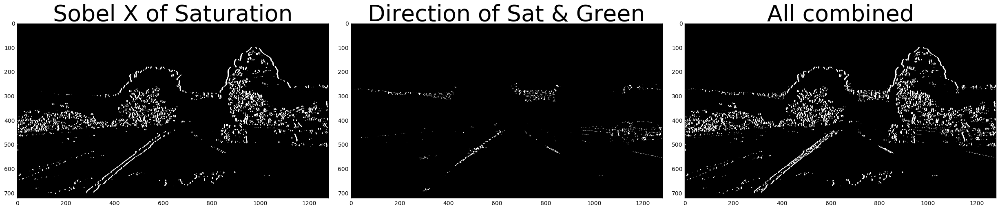

In [18]:
S2 = hls_select(und2, selection='s', thresh=(90, 255))
G2 = rgb_select(und2, selection='g', thresh=(200, 255))

grdx2 = abs_sobel_thresh(S2, orient='x', sobel_kernel=15, thresh=(100, 255))
drec2 = dir_threshold(S2, sobel_kernel=15, thresh=(.9, 1.2))

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(grdx2, cmap='gray')
ax1.set_title('Sobel X of Saturation', fontsize=40)
ax2.imshow(drec2 & G2, cmap='gray')
ax2.set_title('Direction of Sat & Green', fontsize=40)
ax3.imshow(grdx2 | (drec2 & G2), cmap='gray')
ax3.set_title('All combined', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.show()

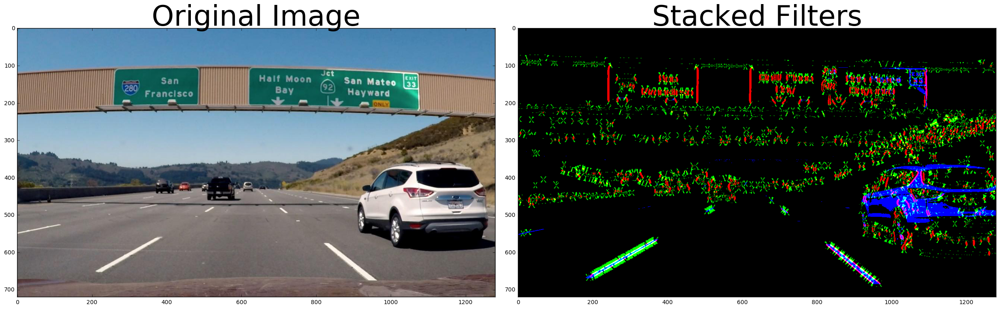

In [19]:
S1 = hls_select(und1, selection='s', thresh=(90, 255))
G1 = rgb_select(und1, selection='g', thresh=(200, 255))

grdx1 = abs_sobel_thresh(S1, orient='x', sobel_kernel=15, thresh=(100, 255))
drec1 = dir_threshold(S1, sobel_kernel=15, thresh=(.9, 1.2))

color1 = np.zeros(S1.shape + (3,), dtype=int)
color1[:,:,0] = grdx1
color1[:,:,1] = drec1
color1[:,:,2] = G1

plot_side_by_side(udimg1, 'Original Image', color1, 'Stacked Filters')

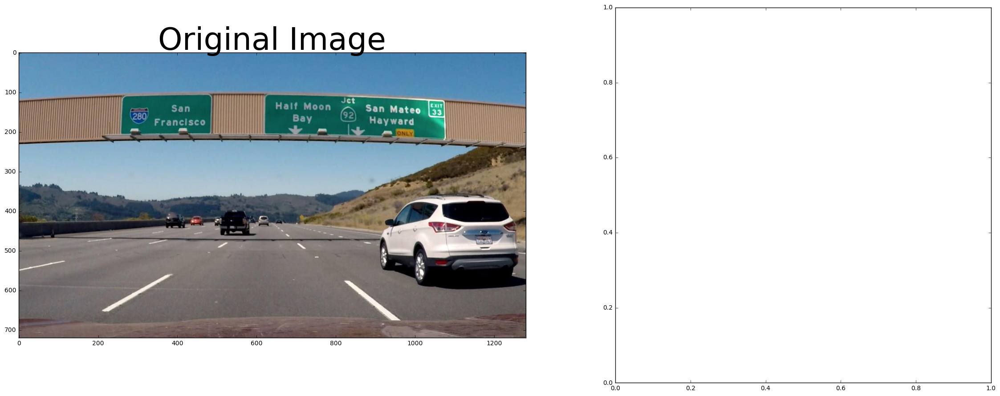

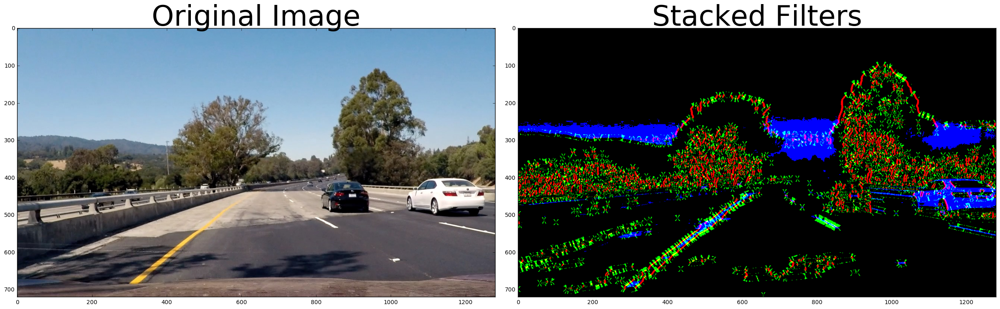

In [39]:
S2 = hls_select(und2, selection='s', thresh=(90, 255))
G2 = rgb_select(und2, selection='g', thresh=(200, 255))

grdx2 = abs_sobel_thresh(S2, orient='x', sobel_kernel=15, thresh=(100, 255))
drec2 = dir_threshold(S2, sobel_kernel=15, thresh=(.9, 1.2))

color2 = np.zeros(S2.shape + (3,), dtype=int)
color2[:,:,0] = grdx2
color2[:,:,1] = drec2
color2[:,:,2] = G2

plot_side_by_side(udimg2, 'Original Image', color2, 'Stacked Filters')

In [40]:
def extract_yellow(img):
    img = gaussian_blur(img, 1)
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    mask = cv2.inRange(hsv, (intv1[0], intv2[0], intv3[0]), (intv1[1], intv2[1], intv3[1]))

    plt.imshow(mask, cmap='gray')
    
def extract_white(img):
    mask = cv2.inRange(img, 
                       (200, 200, 200), 
                       (255, 255, 255))

    plt.imshow(mask, cmap='gray')

In [36]:
def unwarp(img, mtx, dist):
            
    img_size = (img.shape[1], img.shape[0])    
    x, y = img_size

    src = np.float32([
            (130, 700), (540, 460), (740, 460), (1150, 700),
        ])
    dst = np.float32([
            (380, 720), (380, 0), (900, 0), (900, 720)
        ])

    unwarpped, M = corners_unwarp(img, mtx, dist, src, dst)
    plot_side_by_side(img, 'Undistorted Image', unwarpped, 'Unwarpped Image')
    
    histogram = np.sum(unwarpped[600:,:], axis=0)
    f, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 15))
    f.tight_layout()
    ax1.imshow(unwarpped, cmap='gray')
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2 = plt.subplot(212, sharex=ax1)
    plt.plot(histogram)
    plt.xlim(0, x)
    plt.show()
    
    return unwarpped, M


def detect_binary_lines(img):
    
    X = abs_sobel_thresh(img, orient='x', sobel_kernel=15, thresh=(10, 255))

    SL = hls_select(img, selection='s', thresh=(1, 50))
    SH = hls_select(img, selection='s', thresh=(60, 100))
    M = mag_thresh((SL | SH), sobel_kernel=15, thresh=(10, 255))
    MX = abs_sobel_thresh(M, orient='x', sobel_kernel=15, thresh=(10, 255))

    #plot_imgs([X, M, MX])
    #return subset_roi(np.array((X & M & MX), dtype=np.uint8))
    #return subset_roi(np.array((X), dtype=np.uint8))
    return np.array((X), dtype=np.uint8)
    
def fit_lines(unwarpped):
    left = np.zeros_like(unwarpped)
    left[:,:unwarpped.shape[1]//2] = unwarpped[:,:unwarpped.shape[1]//2]

    right = np.zeros_like(unwarpped)
    right[:,unwarpped.shape[1]//2:] = unwarpped[:,unwarpped.shape[1]//2:]

    lpoints = cv2.findNonZero(left)
    rpoints = cv2.findNonZero(right)

    lyvals = lpoints[:,:,1].squeeze()
    ryvals = rpoints[:,:,1].squeeze()

    # Fit a second order polynomial to each fake lane line
    left_fit = np.polyfit(lyvals, lpoints[:,:,0].squeeze(), 2)
    #left_fitx = left_fit[0]*lyvals**2 + left_fit[1]*lyvals + left_fit[2]
    left_fitx = left_fit[0]*np.arange(720)**2 + left_fit[1]*np.arange(720) + left_fit[2]

    right_fit = np.polyfit(ryvals, rpoints[:,:,0].squeeze(), 2)
    #right_fitx = right_fit[0]*ryvals**2 + right_fit[1]*ryvals + right_fit[2]
    right_fitx = right_fit[0]*np.arange(720)**2 + right_fit[1]*np.arange(720) + right_fit[2]

    ## PLOTTING
    plt.plot(lpoints[:,:,0].squeeze(), lpoints[:,:,1].squeeze(), 'b.', markersize=3)
    plt.plot(rpoints[:,:,0].squeeze(), rpoints[:,:,1].squeeze(), 'r.', markersize=3)

    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(left_fitx, np.arange(720), color='green', linewidth=3)
    plt.plot(right_fitx, np.arange(720), color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    plt.show()
    return lpoints, left_fitx, left_fit, rpoints, right_fitx, right_fit
    

NUM_BANDS = 25
TRACK_THRESHOLD = 20
BOX_HALF_WIDTH = 50

def fit_lines2(unwarpped):

    # find the curve
    left, right = get_lane_points(unwarpped)
    left_fitx, left_valsy, left_fit = fit_curve(left)
    right_fitx, right_valsy, right_fit = fit_curve(right)
    
    f, (ax1) = plt.subplots(1, 1, figsize=(20,10))
    ax1.set_title('')
    ax1.imshow(unwarpped, cmap='gray')
    add_points(ax1, left, 'b.')
    add_points(ax1, right, 'r.')
    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(left_fitx, left_valsy, color='green', linewidth=3)
    plt.plot(right_fitx, right_valsy, color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    plt.show()
    
    return left, left_fitx, left_fit, right, right_fitx, right_fit

def find_point(histogram_, avg_height_, is_initialized_, min_edge_, max_edge_, last_center_, list_):
    # decide width to look in for max
    if is_initialized_ == True:
        left_edge = last_center_ - BOX_HALF_WIDTH
        right_edge = last_center_ + BOX_HALF_WIDTH            
    else:
        left_edge = min_edge_
        right_edge = max_edge_

    #print('\t(L_edge,R_edge)=({},{})'.format(left_edge, right_edge))
    # find the max
    center_guess = np.argmax(histogram_[left_edge:right_edge])+left_edge
    center_value = histogram_[center_guess]
    #print('\tcenter_guess: ', center_guess)
    #print('\tcenter_value: ', center_value)
    if center_value > TRACK_THRESHOLD:
        #print('\tappending...')
        list_.append((center_guess, avg_height_))
        last_center_ = center_guess
        if is_initialized_ == False:
            is_initialized_ = True

    return is_initialized_, last_center_, list_


def get_lane_points(img_):
    left = []
    right = []
    
    #band_start = img_.shape[0]
    band_depth = int(img_.shape[0]/NUM_BANDS)
    
    tops = np.arange(0, img_.shape[0]-1, band_depth)
    bottoms = tops + (band_depth-1)
    
    # reverse the arrays
    tops = tops[::-1]
    bottoms = bottoms[::-1]
    
    is_left_initialized = False
    is_right_initialized = False
    last_left_center = 0
    last_right_center = 0
    
    for index in range(len(tops)):
        print('(top, bottom)=({},{})'.format(tops[index], bottoms[index]))
        histogram = np.sum(img_[tops[index]:bottoms[index],:], axis=0)
        hist_len = histogram.shape[0]
        avg_height = (tops[index] + bottoms[index])/2

        is_left_initialized, last_left_center, left = find_point(histogram,
                                                                 avg_height,
                                                                 is_left_initialized, 
                                                                 0, 
                                                                 int(hist_len/2), 
                                                                 last_left_center, 
                                                                 left)
        
        is_right_initialized, last_right_center, right = find_point(histogram,
                                                                 avg_height,
                                                                 is_right_initialized, 
                                                                 int(hist_len/2), 
                                                                 hist_len-1, 
                                                                 last_right_center, 
                                                                 right)
            
    #print(left)
    
    return left, right
    

def fit_curve(points_):
    # get x and y values
    x_vals = np.asarray([pt_tuple[0] for pt_tuple in points_])
    y_vals = np.asarray([pt_tuple[1] for pt_tuple in points_])
    # Fit a second order polynomial
    fit_coeff = np.polyfit(y_vals, x_vals, 2)
    x_fit = fit_coeff[0]*y_vals**2 + fit_coeff[1]*y_vals + fit_coeff[2]
    return x_fit, y_vals, fit_coeff

def add_points(fig_, points_, marking_):
    for pt_tuple in points_:
        fig_.plot(pt_tuple[0],pt_tuple[1],marking_, markersize=30)

def get_curvature(lpoints, left_fit, rpoints, right_fit):

    if len(lpoints.shape) < 3:
        lpoints = np.array([lpoints])
        rpoints = np.array([rpoints])
    
    print(lpoints.shape, rpoints.shape)
    
    ly_eval = np.max(lpoints[:,:,1].squeeze())
    ry_eval = np.max(rpoints[:,:,1].squeeze())
    print(ly_eval, ry_eval)

    left_curverad = ((1 + (2*left_fit[0]*ly_eval + left_fit[1])**2)**1.5) \
                                 /np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*ry_eval + right_fit[1])**2)**1.5) \
                                    /np.absolute(2*right_fit[0])
    print(left_curverad, right_curverad)
    # Example values: 1163.9    1213.7
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    ly_eval = np.max(lpoints[:,:,1].squeeze())
    ry_eval = np.max(rpoints[:,:,1].squeeze())

    left_fit_cr = np.polyfit(lpoints[:,:,1].squeeze()*ym_per_pix, lpoints[:,:,0].squeeze()*xm_per_pix, 2)
    right_fit_cr = np.polyfit(rpoints[:,:,1].squeeze()*ym_per_pix, rpoints[:,:,0].squeeze()*xm_per_pix, 2)

    left_curverad = ((1 + (2*left_fit_cr[0]*ly_eval + left_fit_cr[1])**2)**1.5) \
                                 /np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*ry_eval + right_fit_cr[1])**2)**1.5) \
                                    /np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')

    return left_curverad, right_curverad

def warp_back(image, warped, left_fitx, right_fitx):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    print(left_fitx)
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, np.arange(720)]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, np.arange(720)])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    img_size = (image.shape[1], image.shape[0])    
    Minv = get_perspective(img_size, inv=True)
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    plt.imshow(result)
    plt.show()
    return result

def pipeline(img, mtx, dist):
    # undistort
    und = undistort(img, mtx, dist)
    binl = detect_binary_lines(und)
    unwarpped, M = unwarp(binl, mtx, dist)
    lpoints, left_fitx, left_fit, rpoints, right_fitx, right_fit = fit_lines2(unwarpped)
    lcurve, rcurve = get_curvature(lpoints, left_fit, rpoints, right_fit)
    result = warp_back(und, unwarpped, left_fitx, right_fitx)
    return result
    

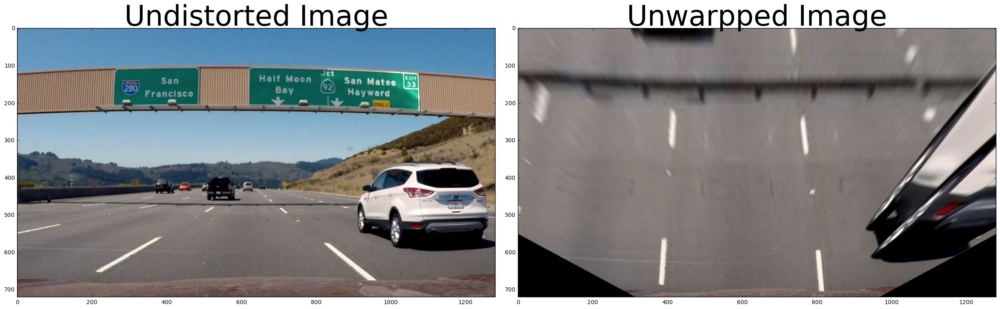

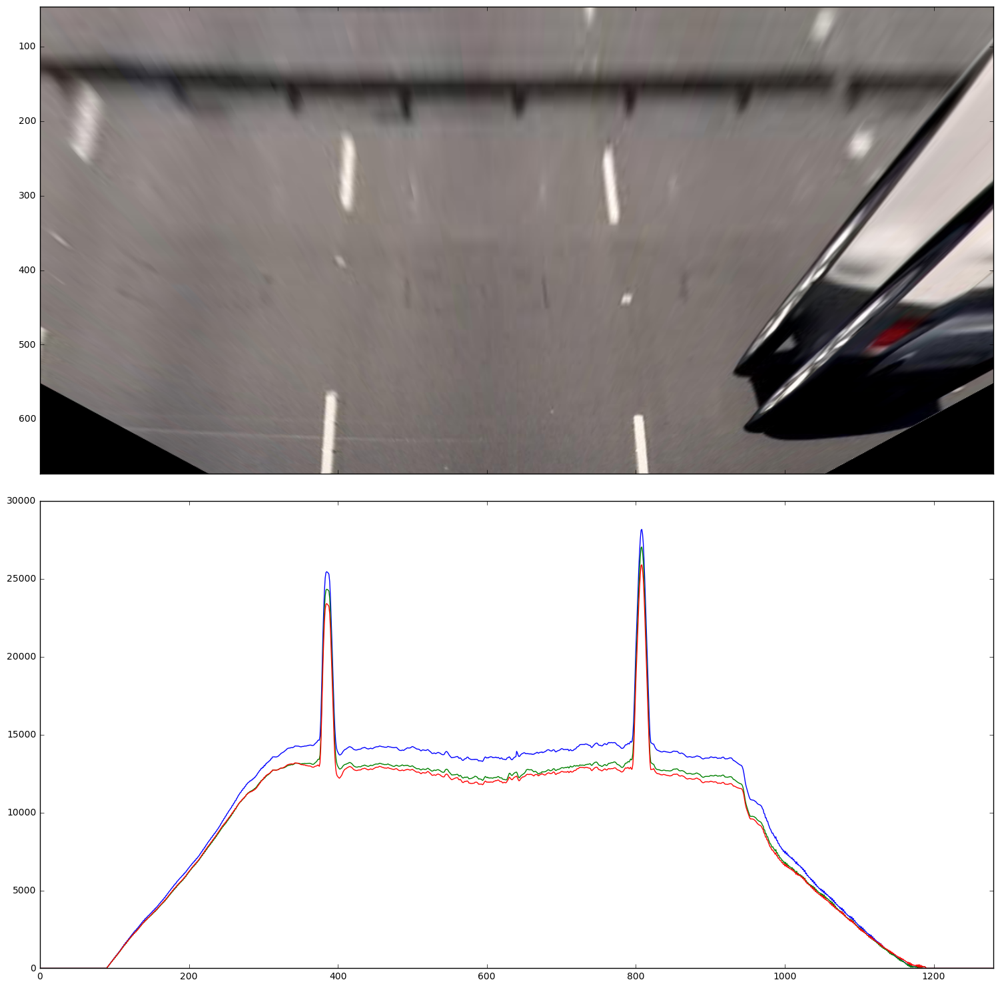

TypeError: Image data can not convert to float

In [38]:
plot_side_by_side(udimg1, 'Original Image', unwarp(udimg1, udmtx, uddist), 'Binary image')

plot_side_by_side(udimg1, 'Original Image', pipeline(udimg1, udmtx, uddist), 'Binary image')


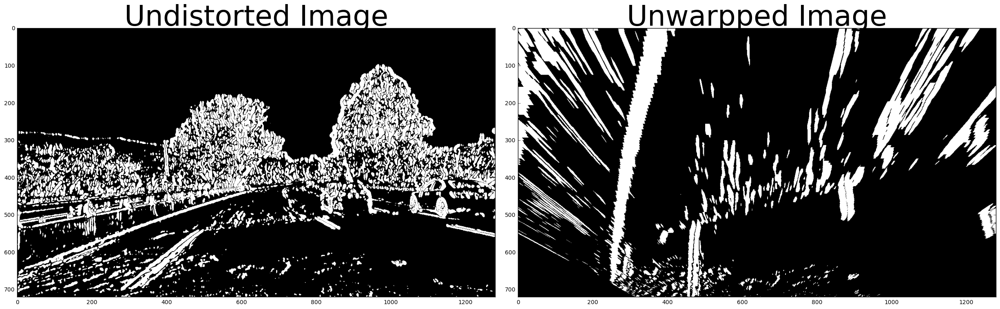

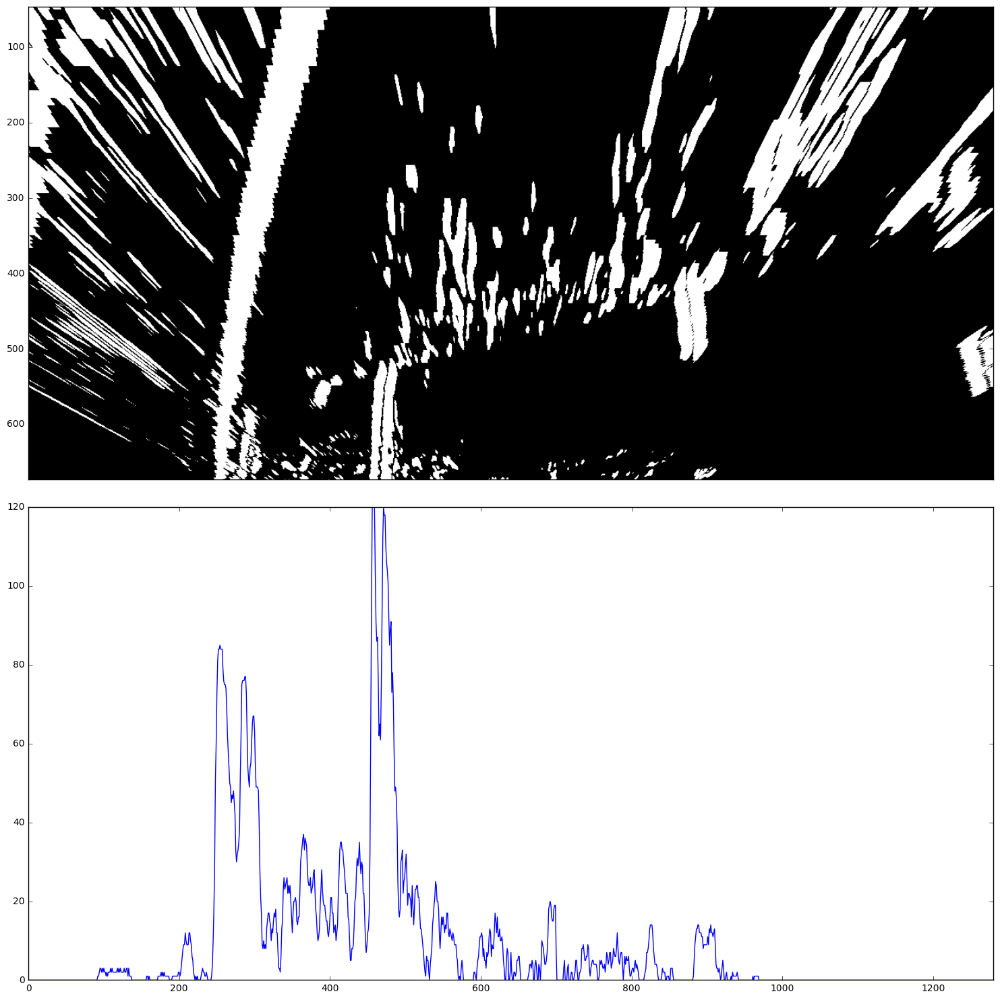

(top, bottom)=(700,727)
(top, bottom)=(672,699)
(top, bottom)=(644,671)
(top, bottom)=(616,643)
(top, bottom)=(588,615)
(top, bottom)=(560,587)
(top, bottom)=(532,559)
(top, bottom)=(504,531)
(top, bottom)=(476,503)
(top, bottom)=(448,475)
(top, bottom)=(420,447)
(top, bottom)=(392,419)
(top, bottom)=(364,391)
(top, bottom)=(336,363)
(top, bottom)=(308,335)
(top, bottom)=(280,307)
(top, bottom)=(252,279)
(top, bottom)=(224,251)
(top, bottom)=(196,223)
(top, bottom)=(168,195)
(top, bottom)=(140,167)
(top, bottom)=(112,139)
(top, bottom)=(84,111)
(top, bottom)=(56,83)
(top, bottom)=(28,55)
(top, bottom)=(0,27)


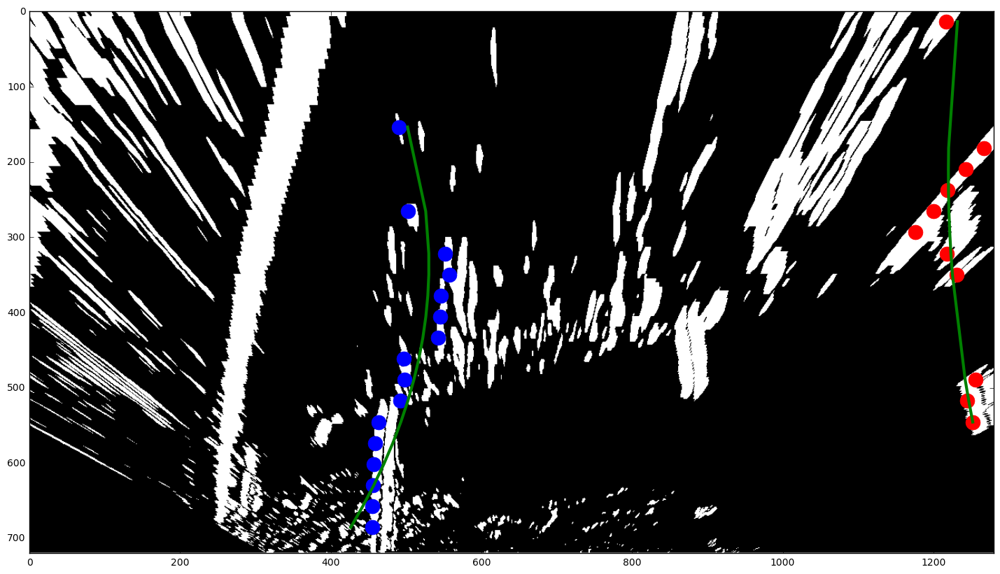

AttributeError: 'list' object has no attribute 'shape'

In [35]:
plot_side_by_side(udimg2, 'Original Image', pipeline(udimg2, udmtx, uddist), 'Binary image')

In [41]:
mymtx, mydist = calibrate(mpimg.imread(fnames[0]).shape[:2], myobjpoints, myimgpoints)

fnames = glob.glob('./my_images/*')
print()
for fname in fnames[:5]:
    img = ndimage.imread(fname)
    plot_side_by_side(img, 'Original Image', pipeline(img, mymtx, mydist), 'Binary image')

NameError: name 'fnames' is not defined

#### Perspective Transform

#### Identifying Lane Line Pixels

#### Lane Curvature and Car Positioning

#### Putting Everything Together

### Processing Video

#### Confidence-Based Lane Detection

#### Confidence-Based Lane Tracking

### Results

#### Provided Videos

#### New Videos

### Reflections

#### Further Improvements

#### Hypothetical flaws